# **Building a Reverse Image Search Engine**


#**1.    Environment preparation**

In [ ]:
# pip install torch==1.10.0+cu113 torchvision==0.11.1+cu113 torchaudio==0.10.0+cu113 -f https://download.pytorch.org/whl/cu113/torch_stable.html
#

### Loading libraries

In [2]:
import os
import time
import tqdm
import torch
import pickle
import torchvision
import torchmetrics
import sys
from pathlib import Path
from numpy.linalg import norm

from torchvision.io import read_image
from torchvision.models import resnet50
from sklearn.neighbors import NearestNeighbors
from torch.utils.data import Subset, DataLoader
from sklearn.model_selection import train_test_split

import numpy as np
import torch.nn as nn
import pytorch_lightning as pl

In [3]:
torch.cuda.is_available()

True

# **Datasets**

In [4]:
convert_to_tensor = torchvision.transforms.Compose([torchvision.transforms.Resize([224, 224]),
                                                    torchvision.transforms.ToTensor()])

Wczytanie datasetu z użyciem ImageFolder. ImageFolder tworzy dataset z podziałem na klasy wg nazw folderów, które znajdują się w głównym folderze, który podajemy na wejście.

Caltech101

In [5]:
caltech_path = Path("../datasets/caltech101/101_ObjectCategories/")

In [6]:
caltech_dataset = torchvision.datasets.ImageFolder(root=caltech_path, transform=convert_to_tensor)

In [7]:
datasets = {}
train_idx, test_idx = train_test_split(list(range(len(caltech_dataset))), test_size=0.4, stratify=caltech_dataset.targets, random_state=42)
datasets['train'] = Subset(caltech_dataset, train_idx)
datasets['train_filenames'] = [caltech_dataset.samples[idx][0] for idx in train_idx]
datasets['test'] = Subset(caltech_dataset, test_idx)
datasets['test_filenames'] = [caltech_dataset.samples[idx][0] for idx in test_idx]

ChestXrayMED

In [8]:
train_med_path = Path("../datasets/chest_xray/train/")
test_med_path = Path("../datasets/chest_xray/test/")

In [9]:
train_med_dataset = torchvision.datasets.ImageFolder(root=train_med_path, transform=convert_to_tensor)
test_med_dataset = torchvision.datasets.ImageFolder(root=test_med_path, transform=convert_to_tensor)

# **2. Extracting features from raw pretrained model [FEATURES ARE SAVED AS PICKLE]**

## **2.1 Model preparation**

In [10]:
# model
model = resnet50(pretrained=True)

Odcięcie warstwy FC

In [11]:
# device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
no_bottleneck_resnet = nn.Sequential(*list(model.children())[:-1])

for param in no_bottleneck_resnet.parameters():
  param.requires_grad = False # freezed pretrained layers

# bottleneck_resnet = bottleneck_resnet.to(device)

In [12]:
class FeatureExtractor(pl.LightningModule):
  def __init__(self):
      super().__init__()

      self.network = no_bottleneck_resnet
      
      self.loss_function = nn.CrossEntropyLoss()
      self.accuracy = torchmetrics.Accuracy()

  def forward(self, x):
    return self.network(x) 

  def training_step(self, batch, batch_idx):
        inputs, labels = batch
        outputs = self(inputs)
        loss = self.loss_function(outputs, labels)

        self.accuracy(torch.log_softmax(outputs), labels.type(torch.int64))
        self.log('train_acc', self.accuracy, prog_bar=True)
        
        return loss

  def test_step(self, batch, batch_idx):
        inputs, labels = batch
        outputs = self(inputs)
        
        loss = self.loss_function(outputs, labels)
        self.log('test_loss', loss, prog_bar=True)
        self.accuracy(torch.log_softmax(outputs), labels.type(torch.int64))
        self.log('test_acc', self.accuracy, prog_bar=True)

  def configure_optimizers(self):
      return torch.optim.Adam(self.parameters(), lr=1e-3)

  def predict_step(self, batch, batch_idx: int , dataloader_idx: int = None):
    inputs, labels = batch
    return self(inputs), labels

## **2.2 Batch preparation**

In [13]:
batch_size = 1

Caltech101

In [14]:
dataloaders = {x:DataLoader(datasets[x],batch_size, shuffle=False, num_workers=4) for x in ['train','test']} 

ChestXrayMED

In [15]:
train_med_dataloader = DataLoader(train_med_dataset, batch_size=batch_size, shuffle=False, num_workers=4)

## **2.3 Feature extraction from raw model **

Caltech101

In [16]:
ft_net = FeatureExtractor()

extracted_features = {}

trainer_extract = pl.Trainer(gpus=1)
extracted_features['train'] = trainer_extract.predict(ft_net, dataloaders['train'])
extracted_features['test'] = trainer_extract.predict(ft_net, dataloaders['test'])
extracted_features['train_filenames'] = datasets['train_filenames']
extracted_features['test_filenames'] = datasets['test_filenames']

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: 100%|██████████| 651/651 [02:06<00:00,  5.13it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Predicting: 100%|██████████| 434/434 [01:28<00:00,  4.90it/s]


ChestXrayMED

In [10]:
ft_net = FeatureExtractor()
trainer_extract = pl.Trainer(gpus=1)

med_extracted_ft = []

med_extracted_ft = trainer_extract.predict(ft_net, train_med_dataloader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: 100%|██████████| 5216/5216 [03:02<00:00, 28.51it/s]


Saving features

In [64]:
pickle.dump(extracted_features, open(Path('../models/extracted_features-caltech101.pickle'), 'wb'))

In [11]:
med_train_dataset = {}
med_train_dataset['train_filenames'] = [train_med_dataset.samples[i][0] for i in range(len(train_med_dataset))]
med_train_dataset['train_features'] = med_extracted_ft

In [12]:
pickle.dump(med_train_dataset, open('../models/extracted_features-train_med.pickle', 'wb'))

# **3. Results and visualisation from raw pretrained model [Caltech101]**

## **3.1 Similarity Search**

Jednym ze sposobów okreslenia podobieństwa obrazów do siebie jest uczenie metryczne czyli porównanie ich odległości w przestrzenii. Co porównać? Najlepiej wyekstraktować cechy z obrazów na pretrenowanym modelu na jakimś bardzo dużym zbiorze obrazów.

In [72]:
extracted_features = pickle.load(open('../models/extracted_features-caltech101.pickle', 'rb'))

In [73]:
train_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features['train']]
train_class_list = [tensor[1].tolist()[0] for tensor in extracted_features['train']]
train_filenames_list = [filename for filename in extracted_features['train_filenames']]

test_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features['test']]
test_class_list = [tensor[1].tolist()[0] for tensor in extracted_features['test']]
test_filenames_list = [filename for filename in extracted_features['test_filenames']]

In [74]:
np.shape(train_features_list)

(5206, 2048)

features list should be n_samples, n_features

Podajemy jako query image features_list[0], czyli filenames[0]

In [76]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute', metric='euclidean').fit(train_features_list)
distances, indices = neighbors.kneighbors([train_features_list[0]])

In [77]:
distances, indices

(array([[1.43051147e-06, 1.47760272e+01, 1.52724898e+01, 1.53097182e+01,
         1.56288535e+01]]),
 array([[   0, 3003, 4415, 1119,   87]], dtype=int64))

Wiec dla indeksu 0 mamy dystans 0 bo to jest to samo zdjęcie, natomiast dla indeksów 435,19,22,18 mamy podobne dystanse może je zobaczyć

In [78]:
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
# %matplotlib inline 

Przegląd losowych 5 zdjęć i 5 podobnych do nich zdjęć włącznie z tym podanym na wejście

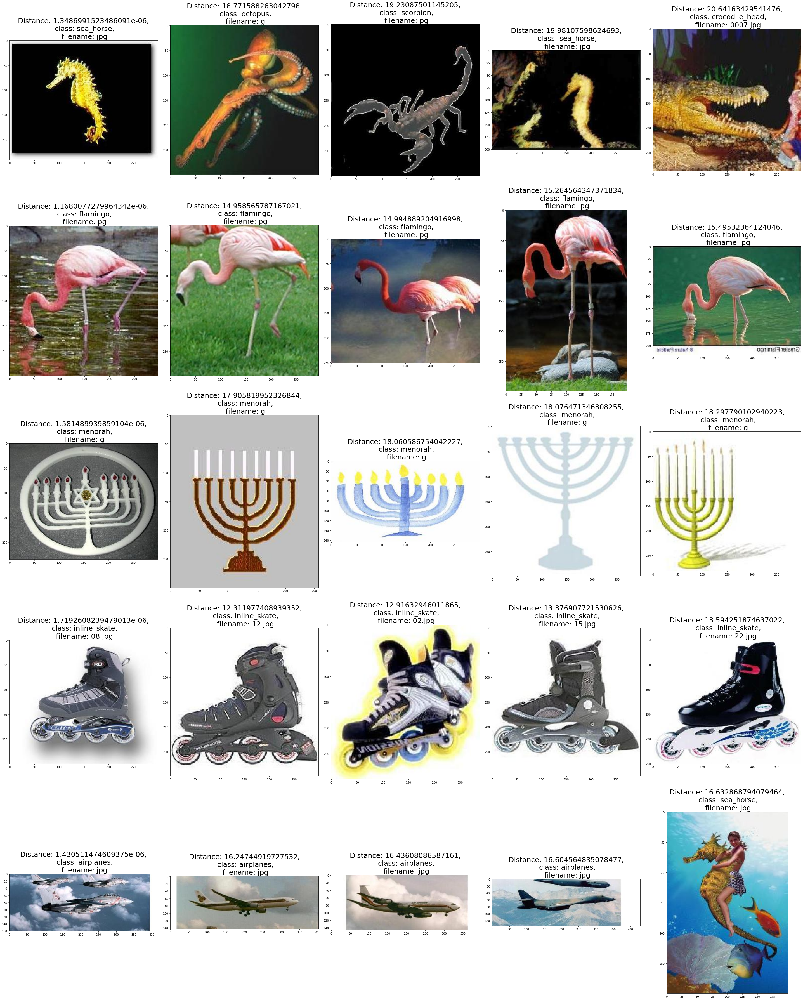

In [80]:
fig, ax = plt.subplots(5, 5, figsize=(40, 50))

for i in range(5):
  rand_idx = random.randint(0, len(train_filenames_list))
  distances, indices = neighbors.kneighbors([train_features_list[rand_idx]])
  for j, idx in enumerate(indices[0]):
    ax[i][j].set_title(f'Distance: {distances[0][j]},\n class: {caltech_dataset.classes[train_class_list[idx]]},\n filename: {train_filenames_list[idx][65:]}', fontsize=25)
    ax[i][j].imshow(mpimg.imread(train_filenames_list[idx]))
fig.tight_layout()

## **3.2 Visualising Image Clusters with t-SNE**

In [81]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

**PCA**  (*Principal Component Alalysis*) is used to first reducing the dimensions of the feature before using **t-SME **(*t-distributed stochastic neighbor embedding*) algorithm to reduce high-dimensional featore vector to 2D.

Możemy uzyskać większą szybkość poprzez redukcję wektora cech lub lepszym algorytmem.

Redukcja np. za pomocą PCA z 2048 do 100 cech, nastepnie sprawdzenie wariacnji między tymi cechami żeby zobaczyć czy są od siebie bardzo zależne czy nie. Jeśli nie to faktycznie może lepiej zmniejszyć ilość cech zyskując o wiele większą szybkość działania.

In [82]:
num_feature_dimensions = 200      # Set the number of features
pca = PCA(n_components=num_feature_dimensions)
pca.fit(train_features_list)
features_list_compressed = pca.transform(train_features_list)

In [83]:
np.shape(features_list_compressed)

(5206, 200)

TSNE pozwala zwizualizować wielowymiarowe dane

In [84]:
tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(features_list_compressed)

e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5206 samples in 0.001s...
[t-SNE] Computed neighbors for 5206 samples in 1.005s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5206
[t-SNE] Computed conditional probabilities for sample 2000 / 5206
[t-SNE] Computed conditional probabilities for sample 3000 / 5206
[t-SNE] Computed conditional probabilities for sample 4000 / 5206
[t-SNE] Computed conditional probabilities for sample 5000 / 5206
[t-SNE] Computed conditional probabilities for sample 5206 / 5206
[t-SNE] Mean sigma: 4.792176
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.725754
[t-SNE] KL divergence after 1000 iterations: 1.249050


Rozłożenie klas w przestrzenii na podstawie wektorów cech 

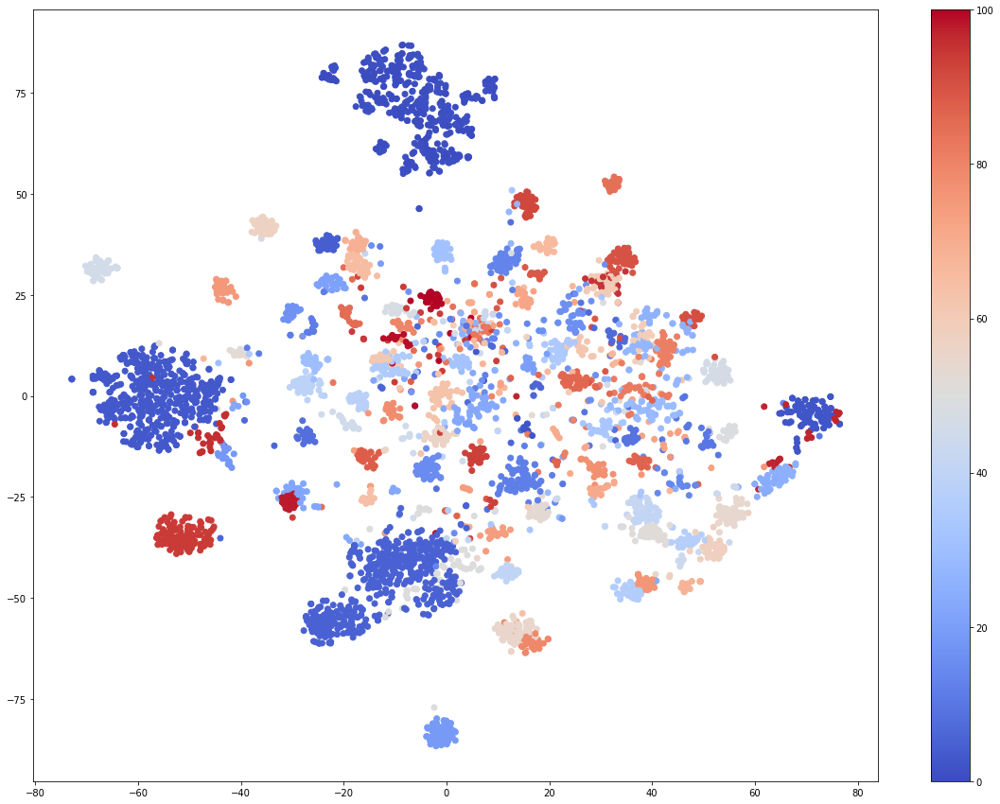

In [85]:
plt.figure(figsize=(20, 15))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c=train_class_list, cmap=plt.cm.get_cmap('coolwarm'))
plt.colorbar()

# **4. Results and visualisation from raw pretrained model [ChestXrayMED]**

Jednym ze sposobów okreslenia podobieństwa obrazów do siebie jest uczenie metryczne czyli porównanie ich odległości w przestrzenii. Co porównać? Najlepiej wyekstraktować cechy z obrazów na pretrenowanym modelu na jakimś bardzo dużym zbiorze obrazów.

In [51]:
extracted_features = pickle.load(open('../models/extracted_features-train_med.pickle', 'rb'))

In [52]:
train_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features['train_features']]
train_class_list = [tensor[1].tolist()[0] for tensor in extracted_features['train_features']]
train_filenames_list = extracted_features['train_filenames']

In [15]:
np.shape(train_features_list)

(5216, 2048)

features list should be n_samples, n_features

Podajemy jako query image features_list[0], czyli filenames[0]

In [53]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute', metric='euclidean').fit(train_features_list)
distances, indices = neighbors.kneighbors([train_features_list[0]])

In [54]:
distances, indices

(array([[1.65181237e-06, 8.51436626e+00, 8.52589462e+00, 8.82442138e+00,
         8.95910007e+00]]),
 array([[  0, 586, 668, 872, 188]], dtype=int64))

Wiec dla indeksu 0 mamy dystans 0 bo to jest to samo zdjęcie, natomiast dla indeksów 435,19,22,18 mamy podobne dystanse może je zobaczyć

In [18]:
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

Przegląd losowych 5 zdjęć i 5 podobnych do nich zdjęć włącznie z tym podanym na wejście

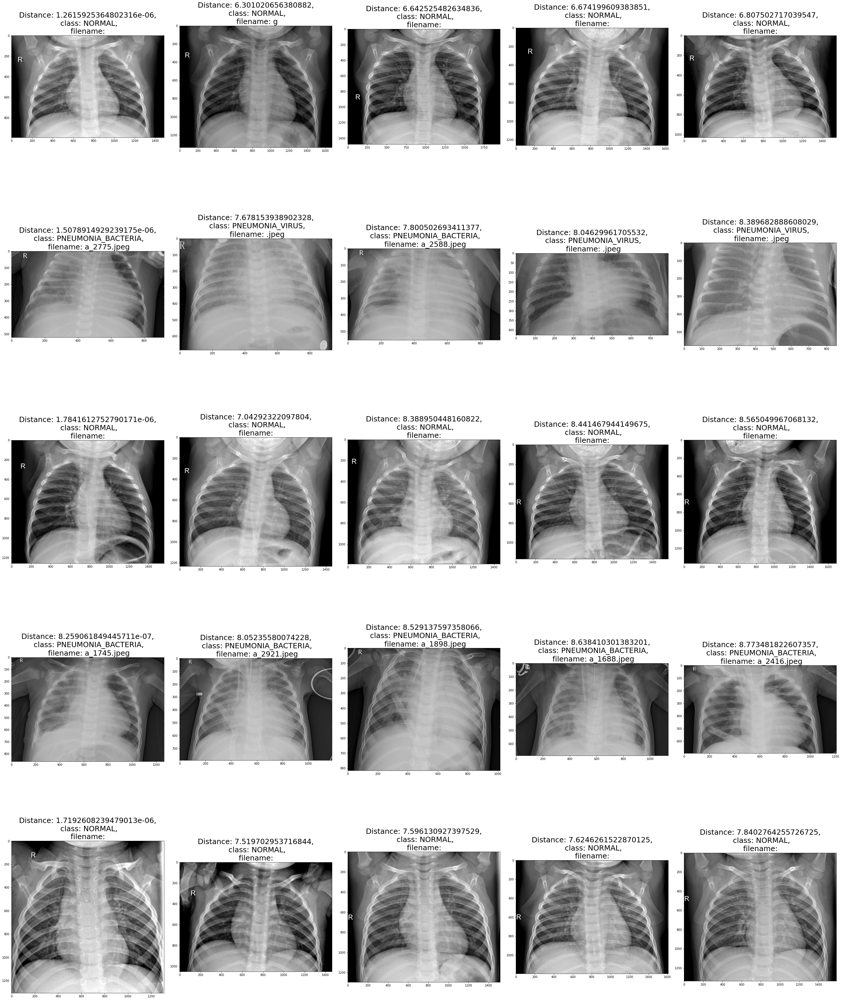

In [19]:
fig, ax = plt.subplots(5, 5, figsize=(40, 50))

for i in range(5):
  rand_idx = random.randint(0, len(train_features_list))
  distances, indices = neighbors.kneighbors([train_features_list[rand_idx]])
  for j, idx in enumerate(indices[0]):
    ax[i][j].set_title(f'Distance: {distances[0][j]},\n class: {train_med_dataset.classes[train_class_list[idx]]},\n filename: {train_filenames_list[idx][65:]}', fontsize=25)
    ax[i][j].imshow(mpimg.imread(train_filenames_list[idx]), cmap='gray')
fig.tight_layout()

## **4.1 Reducing Feature-Length with PCA**

PCA is a statistical procedure that questions whether features representing the data are equally important. PCA is considered one of the go-to techniques for dimensionality reduction. Note that it does not eliminate redundant features; rather, it generates a new set of features that are a linear combination of the input features. These linear features are orthogonal to one another, which is why all the redundant features are absent. These features are known as *principal components*.

In [20]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

In [21]:
num_feature_dimensions = 200      # Set the number of features
pca = PCA(n_components=num_feature_dimensions)
pca.fit(train_features_list)
features_list_compressed = pca.transform(train_features_list)

In [22]:
tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(features_list_compressed)

e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5216 samples in 0.002s...
[t-SNE] Computed neighbors for 5216 samples in 1.042s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5216
[t-SNE] Computed conditional probabilities for sample 2000 / 5216
[t-SNE] Computed conditional probabilities for sample 3000 / 5216
[t-SNE] Computed conditional probabilities for sample 4000 / 5216
[t-SNE] Computed conditional probabilities for sample 5000 / 5216
[t-SNE] Computed conditional probabilities for sample 5216 / 5216
[t-SNE] Mean sigma: 2.610065
[t-SNE] KL divergence after 250 iterations with early exaggeration: 84.730316
[t-SNE] KL divergence after 1000 iterations: 2.367364


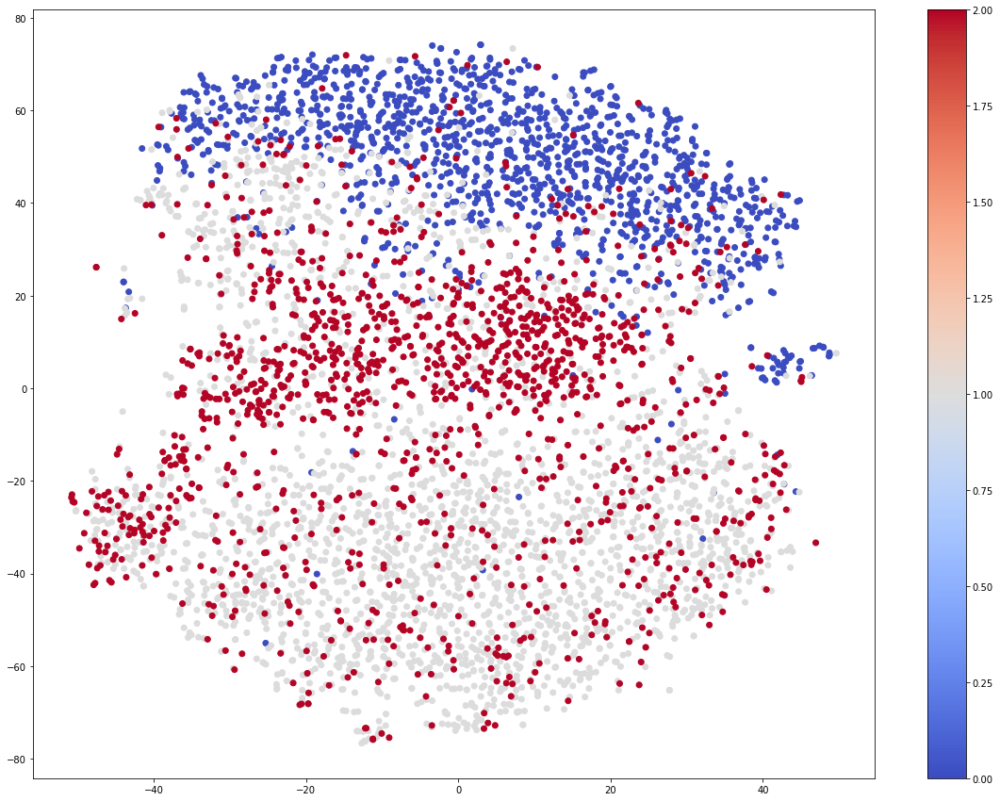

In [23]:
plt.figure(figsize=(20, 15))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c=train_class_list, cmap=plt.cm.get_cmap('coolwarm'))
plt.colorbar()

# **5. Optimized model on dataset and results [Caltech101]**

In [9]:
datasets['train']

In [10]:
datasets['test']

In [11]:
model_ft_caltech = resnet50(pretrained=True)

In [18]:
train_caltech_ft_dt = DataLoader(datasets['train'], batch_size=4, shuffle=False, num_workers=2)

In [19]:
test_caltech_ft_dt = DataLoader(datasets['test'], batch_size=4, shuffle=False, num_workers=2)

In [20]:
val_samples = next(iter(train_caltech_ft_dt))

In [21]:
val_imgs, val_labels = val_samples[0], val_samples[1]
val_imgs.shape, val_labels.shape

(torch.Size([4, 3, 224, 224]), torch.Size([4]))

In [22]:
class Caltech_ft(pl.LightningModule):
  def __init__(self):
      super().__init__()

      # feature extractor
      _layers = list(model_ft_caltech.children())[:-1]
      self.feature_extractor = nn.Sequential(*_layers)

      # classifier
      _fc_layers = [nn.Linear(2048, 1024), nn.ReLU(), nn.Linear(1024, 516), nn.ReLU(), nn.Linear(516, 101)]
      self.fc = nn.Sequential(*_fc_layers)
      
      self.loss_function = nn.NLLLoss()
      self.accuracy = torchmetrics.Accuracy()

  def forward(self, x):
    x = self.feature_extractor(x)
    x = x.squeeze(-1).squeeze(-1)
    x = self.fc(x)
    x = torch.log_softmax(x, dim=1)

    return x 

  def training_step(self, batch, batch_idx):
        x, y = batch
        y_logits = self.forward(x)
        loss = self.loss_function(y_logits, y)
        preds = torch.argmax(y_logits, dim=1)
        acc = self.accuracy(preds, y)

        self.log('train_loss', loss, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        self.log('train_acc', acc, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        
        return loss

  def test_step(self, batch, batch_idx):
        x, y = batch
        y_logits = self.forward(x)
        loss = self.loss_function(y_logits, y)

        preds = torch.argmax(y_logits, dim=1)
        acc = self.accuracy(preds, y)
        
        self.log('test_loss', loss, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        self.log('test_acc', acc, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        
        return loss

  def configure_optimizers(self):
      return torch.optim.Adam(self.parameters(), lr=1e-3)

  def predict_step(self, batch, batch_idx: int , dataloader_idx: int = None):
    inputs, labels = batch
    return self.feature_extractor(inputs), labels

In [23]:
finetune = Caltech_ft()

trainer_ft = pl.Trainer(gpus=1, max_epochs=50)
trainer_ft.fit(finetune, train_caltech_ft_dt)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name              | Type       | Params
-------------------------------------------------
0 | feature_extractor | Sequential | 23.5 M
1 | fc                | Sequential | 2.7 M 
2 | loss_function     | NLLLoss    | 0     
3 | accuracy          | Accuracy   | 0     
-------------------------------------------------
26.2 M    Trainable params
0         Non-trainable params
26.2 M    Total params
104.749   Total estimated model params size (MB)
e:\mgr\venv\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Epoch 1:  23%|██▎       | 298/1302 [01:30<05:04,  3.30it/s, loss=4, v_num=5, train_loss_step=4.250, train_acc_step=0.250, train_loss_epoch=4.230, train_acc_epoch=0.087]    

e:\mgr\venv\lib\site-packages\pytorch_lightning\trainer\trainer.py:688: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [24]:
extracted_features_ft = {}

In [ ]:
extracted_features_ft['train'] = trainer_ft.predict(finetune, train_caltech_ft_dt)
extracted_features_ft['test'] = trainer_ft.predict(finetune, test_caltech_ft_dt)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: 0it [00:00, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: 0it [00:00, ?it/s]

In [40]:
extracted_features_ft['train_filenames'] = datasets['train_filenames']
extracted_features_ft['test_filenames'] = datasets['test_filenames']

In [42]:
pickle.dump(extracted_features_ft, open('../models/extracted_features_finetuned-caltech101.pickle', 'wb'))

In [43]:
extracted_features_ft = pickle.load(open('../models/extracted_features_finetuned-caltech101.pickle', 'rb'))

In [44]:
train_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features_ft['train']]
train_class_list = [tensor[1].tolist()[0] for tensor in extracted_features_ft['train']]
train_filenames_list = [filename for filename in extracted_features_ft['train_filenames']]

test_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features_ft['test']]
test_class_list = [tensor[1].tolist()[0] for tensor in extracted_features_ft['test']]
test_filenames_list = [filename for filename in extracted_features_ft['test_filenames']]

In [45]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute', metric='euclidean').fit(train_features_list)
distances, indices = neighbors.kneighbors([train_features_list[0]])

In [46]:
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
# %matplotlib inline 

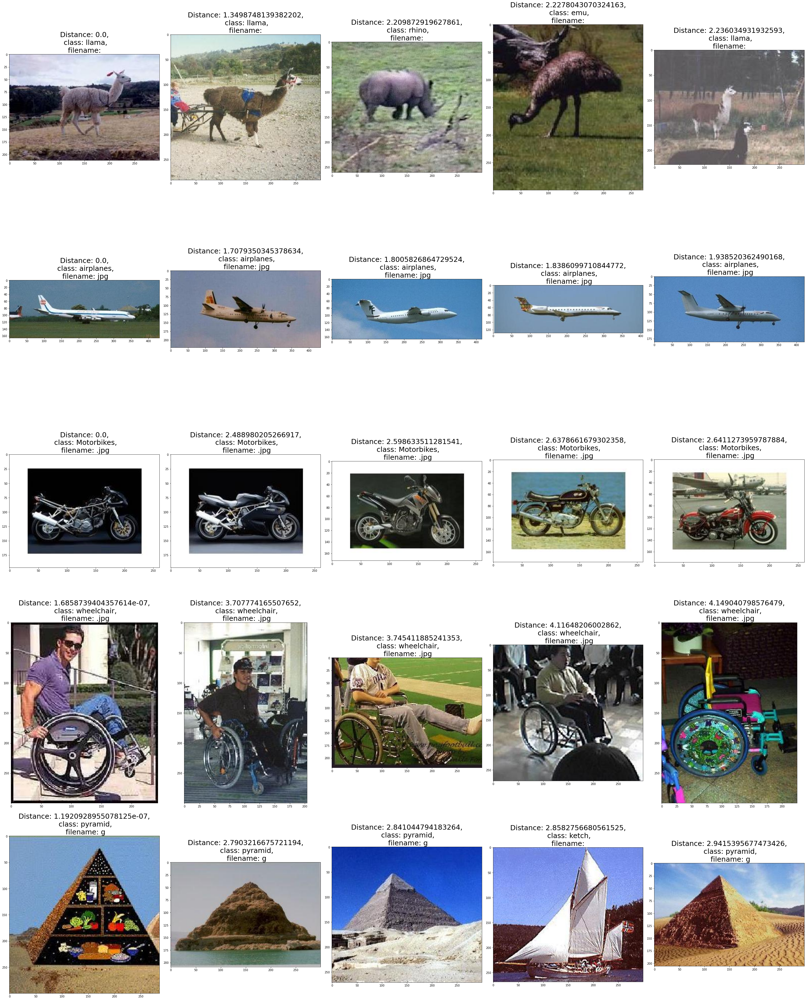

In [47]:
fig, ax = plt.subplots(5, 5, figsize=(40, 50))

for i in range(5):
  rand_idx = random.randint(0, len(train_filenames_list))
  distances, indices = neighbors.kneighbors([train_features_list[rand_idx]])
  for j, idx in enumerate(indices[0]):
    ax[i][j].set_title(f'Distance: {distances[0][j]},\n class: {caltech_dataset.classes[train_class_list[idx]]},\n filename: {train_filenames_list[idx][65:]}', fontsize=25)
    ax[i][j].imshow(mpimg.imread(train_filenames_list[idx]))
fig.tight_layout()

In [48]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

In [49]:
num_feature_dimensions = 200      # Set the number of features
pca = PCA(n_components=num_feature_dimensions)
pca.fit(train_features_list)
features_list_compressed = pca.transform(train_features_list)

e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5206 samples in 0.002s...
[t-SNE] Computed neighbors for 5206 samples in 1.293s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5206
[t-SNE] Computed conditional probabilities for sample 2000 / 5206
[t-SNE] Computed conditional probabilities for sample 3000 / 5206
[t-SNE] Computed conditional probabilities for sample 4000 / 5206
[t-SNE] Computed conditional probabilities for sample 5000 / 5206
[t-SNE] Computed conditional probabilities for sample 5206 / 5206
[t-SNE] Mean sigma: 1.321140
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.260521
[t-SNE] KL divergence after 1000 iterations: 1.137283


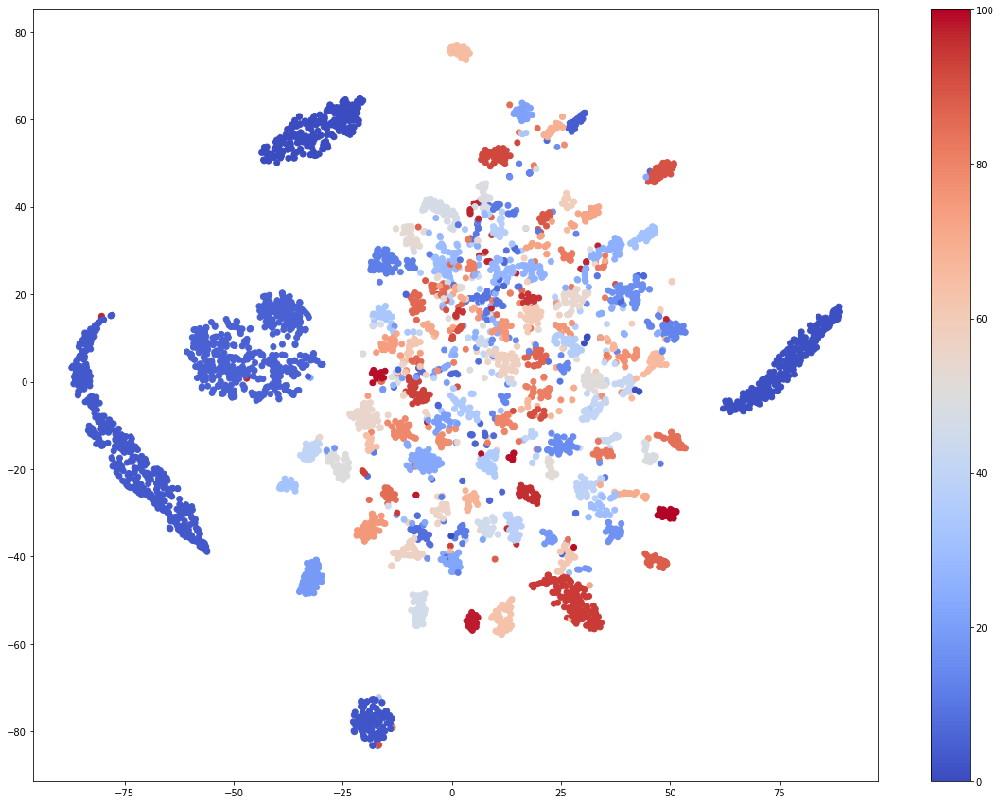

In [50]:
tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(features_list_compressed)
plt.figure(figsize=(20, 15))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c=train_class_list, cmap=plt.cm.get_cmap('coolwarm'))
plt.colorbar()

# **6. Optimized model on dataset and results [ChestXrayMED]**

In [ ]:
model_ft_chest_med = resnet50(pretrained=True)

In [ ]:
train_chest_med_ft_dt = DataLoader(train_med_dataset, batch_size=64, shuffle=True, num_workers=0)
test_chest_med_ft_dt = DataLoader(test_med_dataset, batch_size=64, shuffle=True, num_workers=0)

In [ ]:
val_samples = next(iter(train_chest_med_ft_dt))
val_imgs, val_labels = val_samples[0], val_samples[1]
val_imgs.shape, val_labels.shape

In [ ]:
class ChestXray_ft(pl.LightningModule):
  def __init__(self):
      super().__init__()

      # feature extractor
      _layers = list(model_ft_chest_med.children())[:-1]
      self.feature_extractor = nn.Sequential(*_layers)

      # classifier
      _fc_layers = [nn.Linear(2048, 1024), nn.ReLU(), nn.Linear(1024, 128), nn.ReLU(), nn.Linear(128, 3)]
      self.fc = nn.Sequential(*_fc_layers)
      
      self.loss_function = nn.NLLLoss()
      self.accuracy = torchmetrics.Accuracy()

  def forward(self, x):
    x = self.feature_extractor(x)
    x = x.squeeze(-1).squeeze(-1)
    x = self.fc(x)
    x = torch.log_softmax(x, dim=1)

    return x 

  def training_step(self, batch, batch_idx):
        x, y = batch
        y_logits = self.forward(x)
        loss = self.loss_function(y_logits, y)
        preds = torch.argmax(y_logits, dim=1)
        acc = self.accuracy(preds, y)

        self.log('train_loss', loss, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        self.log('train_acc', acc, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        
        return loss

  def test_step(self, batch, batch_idx):
        x, y = batch
        y_logits = self.forward(x)
        loss = self.loss_function(y_logits, y)

        preds = torch.argmax(y_logits, dim=1)
        acc = self.accuracy(preds, y)
        
        self.log('test_loss', loss, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        self.log('test_acc', acc, on_step=True, on_epoch=True, logger=True, prog_bar=True)
        
        return loss

  def configure_optimizers(self):
      return torch.optim.Adam(self.parameters(), lr=1e-3)

  def predict_step(self, batch, batch_idx: int , dataloader_idx: int = None):
    inputs, labels = batch
    return self.feature_extractor(inputs), labels

In [ ]:
finetune = ChestXray_ft()

trainer_ft = pl.Trainer(gpus=1, max_epochs=25)
trainer_ft.fit(finetune, train_chest_med_ft_dt)

In [ ]:
train_chest_med_ft_dt = DataLoader(train_med_dataset, batch_size=1, shuffle=False, num_workers=0)
test_chest_med_ft_dt = DataLoader(test_med_dataset, batch_size=1, shuffle=False, num_workers=0)

In [ ]:
extracted_features_ft = {}

In [ ]:
extracted_features_ft['train'] = trainer_ft.predict(finetune, train_chest_med_ft_dt)
extracted_features_ft['test'] = trainer_ft.predict(finetune, test_chest_med_ft_dt)

In [22]:
extracted_features_ft['train_filenames'] = [train_med_dataset.samples[i][0] for i in range(len(train_med_dataset))]
extracted_features_ft['test_filenames'] = [test_med_dataset.samples[i][0] for i in range(len(test_med_dataset))]

In [24]:
pickle.dump(extracted_features_ft, open('../models/extracted_features_finetuned-chestxraymed.pickle', 'wb'))

In [25]:
extracted_features_ft = pickle.load(open('../models/extracted_features_finetuned-chestxraymed.pickle', 'rb'))

In [26]:
train_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features_ft['train']]
train_class_list = [tensor[1].tolist()[0] for tensor in extracted_features_ft['train']]
train_filenames_list = [filename for filename in extracted_features_ft['train_filenames']]

test_features_list = [tensor[0].flatten().tolist() for tensor in extracted_features_ft['test']]
test_class_list = [tensor[1].tolist()[0] for tensor in extracted_features_ft['test']]
test_filenames_list = [filename for filename in extracted_features_ft['test_filenames']]

In [27]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute', metric='euclidean').fit(train_features_list)
distances, indices = neighbors.kneighbors([train_features_list[0]])

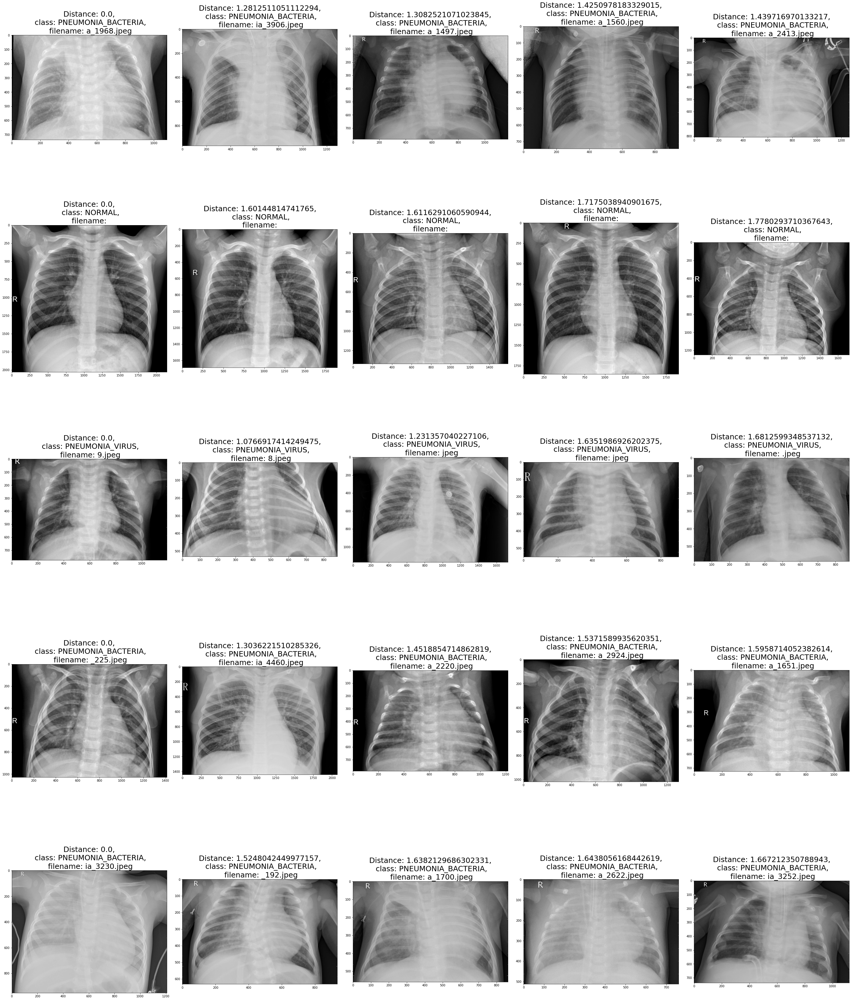

In [29]:
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
# %matplotlib inline 
fig, ax = plt.subplots(5, 5, figsize=(40, 50))

for i in range(5):
  rand_idx = random.randint(0, len(train_features_list))
  distances, indices = neighbors.kneighbors([train_features_list[rand_idx]])
  for j, idx in enumerate(indices[0]):
    ax[i][j].set_title(f'Distance: {distances[0][j]},\n class: {train_med_dataset.classes[train_class_list[idx]]},\n filename: {train_filenames_list[idx][65:]}', fontsize=25)
    ax[i][j].imshow(mpimg.imread(train_filenames_list[idx]), cmap='gray')
fig.tight_layout()

e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
e:\mgr\venv\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5216 samples in 0.002s...
[t-SNE] Computed neighbors for 5216 samples in 0.866s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5216
[t-SNE] Computed conditional probabilities for sample 2000 / 5216
[t-SNE] Computed conditional probabilities for sample 3000 / 5216
[t-SNE] Computed conditional probabilities for sample 4000 / 5216
[t-SNE] Computed conditional probabilities for sample 5000 / 5216
[t-SNE] Computed conditional probabilities for sample 5216 / 5216
[t-SNE] Mean sigma: 1.244124
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.844398
[t-SNE] KL divergence after 1000 iterations: 1.196380


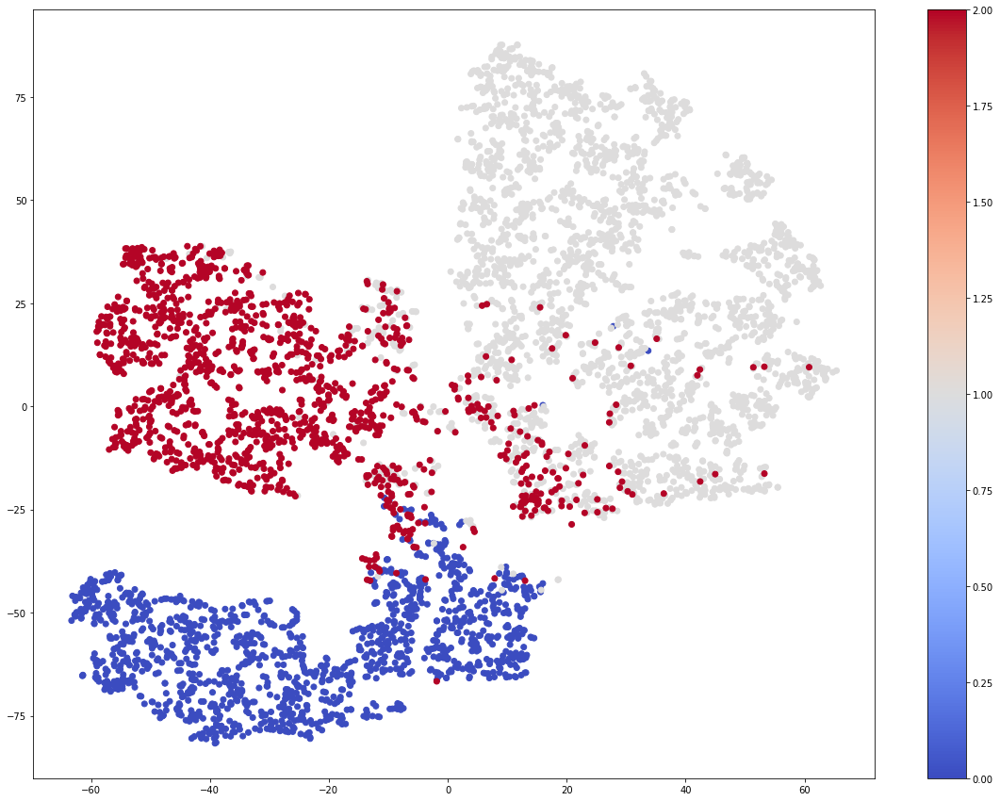

In [30]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

num_feature_dimensions = 200      # Set the number of features
pca = PCA(n_components=num_feature_dimensions)
pca.fit(train_features_list)
features_list_compressed = pca.transform(train_features_list)

tsne_results = TSNE(n_components=2,verbose=1,metric='euclidean').fit_transform(features_list_compressed)
plt.figure(figsize=(20, 15))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c=train_class_list, cmap=plt.cm.get_cmap('coolwarm'))
plt.colorbar()